<a href="https://colab.research.google.com/github/1z2s3e4v/Face-Aging-CAAE-Pytorch/blob/master/dataScience_hw3_Panorama_ver2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')
%pip install opencv-python==3.4.2.16
%pip install opencv-contrib-python==3.4.2.16
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import os
import random

import imageio
import imutils
cv2.ocl.setUseOpenCL(False)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
# select the image id (valid values 1,2,3, or 4)
feature_extractor = 'sift' # one of 'sift', 'surf', 'brisk', 'orb'
feature_matching = 'knn'

In [3]:
input_folder_list_txt = '/content/drive/MyDrive/other/DataScience/hw3/testfile.txt'

In [4]:
def detectAndDescribe(image, method=None):
    """
    Compute key points and feature descriptors using an specific method
    """
    
    assert method is not None, "You need to define a feature detection method. Values are: 'sift', 'surf'"
    
    # detect and extract features from the image
    if method == 'sift':
        descriptor = cv2.xfeatures2d.SIFT_create()
    elif method == 'surf':
        descriptor = cv2.xfeatures2d.SURF_create()
    elif method == 'brisk':
        descriptor = cv2.BRISK_create()
    elif method == 'orb':
        descriptor = cv2.ORB_create()
        
    # get keypoints and descriptors
    (kps, features) = descriptor.detectAndCompute(image, None)
    #print("kps ", type(kps), type(kps[0]))
    #print("feature", type(features), features.shape)
    
    return (kps, features)

In [5]:
def createMatcher(method,crossCheck):
    "Create and return a Matcher Object"
    
    if method == 'sift' or method == 'surf':
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=crossCheck)
    elif method == 'orb' or method == 'brisk':
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=crossCheck)
    return bf

In [6]:
def matchKeyPointsBF(featuresA, featuresB, method):
    bf = createMatcher(method, crossCheck=True)
        
    # Match descriptors.
    best_matches = bf.match(featuresA,featuresB)
    
    # Sort the features in order of distance.
    # The points with small distance (more similarity) are ordered first in the vector
    rawMatches = sorted(best_matches, key = lambda x:x.distance)
    print("Raw matches (Brute force):", len(rawMatches))
    return rawMatches

In [7]:
def matchKeyPointsKNN(featuresA, featuresB, ratio, method):
    bf = createMatcher(method, crossCheck=False)
    # compute the raw matches and initialize the list of actual matches
    rawMatches = bf.knnMatch(featuresA, featuresB, 2)
    print("Raw matches (knn):", len(rawMatches))
    matches = []

    # loop over the raw matches
    for m,n in rawMatches:
        # ensure the distance is within a certain ratio of each
        # other (i.e. Lowe's ratio test)
        if m.distance < n.distance * ratio:
            matches.append(m)
    return matches

In [8]:
def getHomography(kpsA, kpsB, featuresA, featuresB, matches, reprojThresh):
    # convert the keypoints to numpy arrays
    kpsA = np.float32([kp.pt for kp in kpsA])
    kpsB = np.float32([kp.pt for kp in kpsB])
    
    if len(matches) > 4:

        # construct the two sets of points
        ptsA = np.float32([kpsA[m.queryIdx] for m in matches])
        ptsB = np.float32([kpsB[m.trainIdx] for m in matches])
        
        # estimate the homography between the sets of points
        (H, status) = cv2.findHomography(ptsA, ptsB, cv2.RANSAC,
            reprojThresh)

        return (matches, H, status)
    else:
        return None

In [175]:
array_of_img = [] # Store all the image data
stitch_img_cnt = 0
# Read directory function
def read_directory(directory_name):
    filenumber = len([name for name in os.listdir(directory_name) if os.path.isfile(os.path.join(directory_name, name))])
    for i in range(1,filenumber+1):
        img = cv2.imread(directory_name + "/" + str(i)+".jpg")
        array_of_img.append(img)
                         
def SIFT(inputname):
    read_directory(inputname)
    #use: len(array_of_img) for looping the image, array_of_img[0],
    #array_of_img[1],array_of_img[2],...for processing each image
    #Start SIFT here
    print("img_num = " + str(len(array_of_img)))
    #### resize if image is too big
    for i in range(0,len(array_of_img)):
        height, width, channels = array_of_img[i].shape
        if height > 800 :
            array_of_img[i] = cv2.resize(array_of_img[i], (int(width/10),int(height/10)), interpolation=cv2.INTER_CUBIC)
    #### resize end
    #### Start of Panorama
    for i in range(1,len(array_of_img)):
        print("Stitching picture",i)
        # prepare images
        img_left = array_of_img[i]
        img_right = array_of_img[0]
        img_left = cv2.normalize(img_left, None, 0, 255, cv2.NORM_MINMAX).astype('uint8') # make image legal
        img_right = cv2.normalize(img_right, None, 0, 255, cv2.NORM_MINMAX).astype('uint8') # make image legal
        # flip horizontal
        img_left = cv2.flip(img_left, 1)
        img_right = cv2.flip(img_right, 1)

        # The stitch object to stitch the image
        img_left_gray = cv2.cvtColor(img_left, cv2.COLOR_RGB2GRAY)
        img_right_gray = cv2.cvtColor(img_right, cv2.COLOR_RGB2GRAY)

        kpsA, featuresA = detectAndDescribe(img_right_gray, method=feature_extractor) # Transfor
        kpsB, featuresB = detectAndDescribe(img_left_gray, method=feature_extractor) # Query 

        print("Using: {} feature matcher".format(feature_matching))
        fig = plt.figure(figsize=(20,8))
        ## draw image
        if feature_matching == 'bf':
            matches = matchKeyPointsBF(featuresB, featuresA, method=feature_extractor)
            img3 = cv2.drawMatches(img_left,kpsB,img_right,kpsA,matches[:100],
                                  None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
        elif feature_matching == 'knn':
            matches = matchKeyPointsKNN(featuresB, featuresA, ratio=0.75, method=feature_extractor)
            img3 = cv2.drawMatches(img_left,kpsB,img_right,kpsA,np.random.choice(matches,100),
                                  None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS) 
        plt.imshow(cv2.flip(img3,1))
        plt.show()
        ## get real matches
        if feature_matching == 'bf':
            matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
        elif feature_matching == 'knn':
            matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.75, method=feature_extractor)
        
        M = getHomography(kpsA, kpsB, featuresA, featuresB, matches, reprojThresh=4)
        if M is None:
            print("Error!")
        (matches, H, status) = M
        print(H)

        # Apply panorama correction
        width = img_right.shape[1] + img_left.shape[1]
        height = img_right.shape[0] + img_left.shape[0]

        result = cv2.warpPerspective(img_right, H, (width, height))
        result[0:img_left.shape[0], 0:img_left.shape[1]] = img_left

        # transform the panorama image to grayscale and threshold it 
        gray = cv2.cvtColor(result, cv2.COLOR_BGR2GRAY)
        thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)[1]
        # Finds contours from the binary image
        cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        cnts = imutils.grab_contours(cnts)
        # get the maximum contour area
        c = max(cnts, key=cv2.contourArea)
        # get a bbox from the contour area
        (x, y, w, h) = cv2.boundingRect(c)
        # crop the image to the bbox coordinates
        result = result[y:y + h, x:x + w]
        
        result = cv2.flip(result,1)

        array_of_img[0] = result
    #### End of Panorama

    #End of SIFT here and use imageoutput for your output
    imageoutput = array_of_img[0]
    array_of_img.clear()
    return imageoutput

# Main

In [176]:
def run_main(file_txt):
  f = open(file_txt, 'r')
  dirname = str(f.readline()).strip()
  dirname = str(f.readline()).strip()
  while(dirname):
      print("\nimage folder: "+dirname)
      imageout=SIFT(dirname)
      plt.figure()
      plt.imshow(imageout)
      cv2.imwrite(dirname+'.jpg', imageout)
      dirname = str(f.readline()).strip()


image folder: /content/drive/MyDrive/other/DataScience/hw3/parrington
img_num = 17
Stitching picture 1
Using: knn feature matcher
Raw matches (knn): 2144


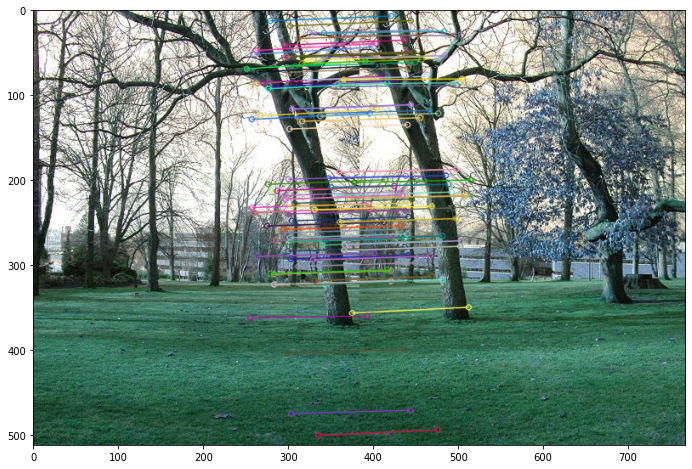

Raw matches (knn): 2089
[[ 8.69730940e-01  1.33650672e-02  2.44323955e+02]
 [-8.83242363e-02  9.75948223e-01  1.97733391e+00]
 [-3.38913846e-04  6.93709242e-07  1.00000000e+00]]
Stitching picture 2
Using: knn feature matcher
Raw matches (knn): 2129


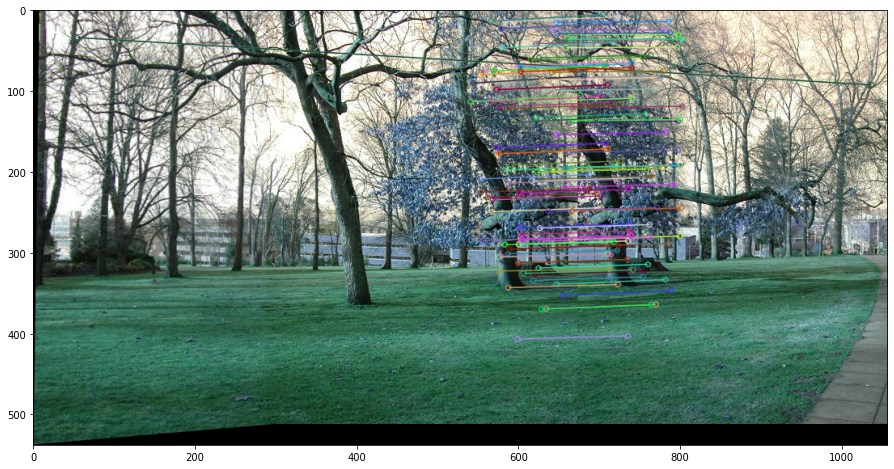

Raw matches (knn): 4354
[[ 8.68656015e-01  1.26569344e-02  2.46962723e+02]
 [-9.00317043e-02  9.77765644e-01  1.73048060e+00]
 [-3.47769012e-04  2.49789175e-06  1.00000000e+00]]
Stitching picture 3
Using: knn feature matcher
Raw matches (knn): 1659


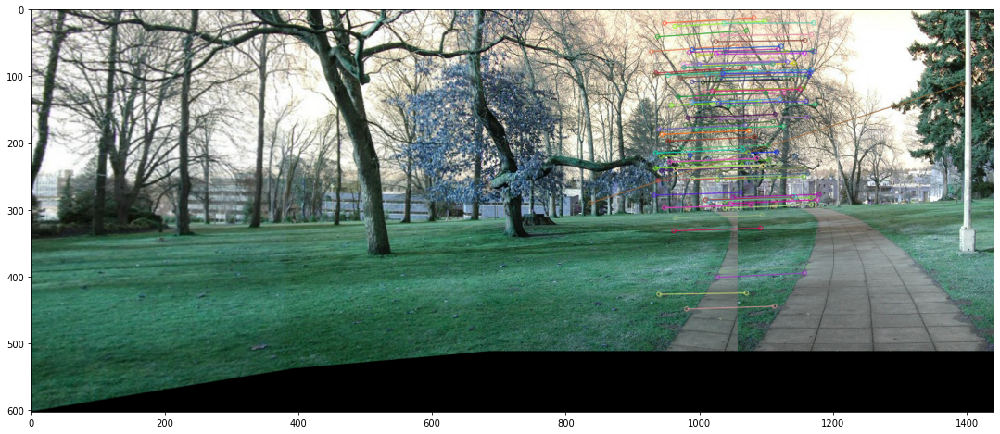

Raw matches (knn): 7390
[[ 8.63292086e-01  1.40909739e-02  2.52179303e+02]
 [-9.25765600e-02  9.77934450e-01  1.43576297e+00]
 [-3.57040636e-04  2.52416028e-06  1.00000000e+00]]
Stitching picture 4
Using: knn feature matcher
Raw matches (knn): 1649


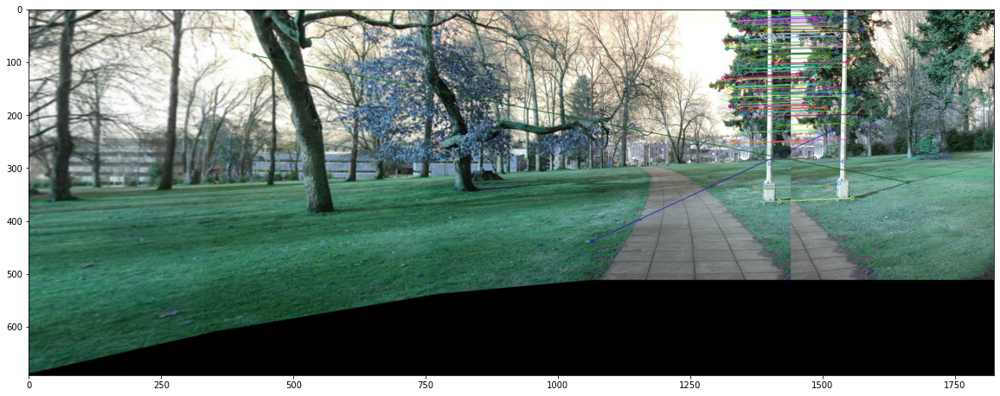

Raw matches (knn): 9002
[[ 8.71534383e-01  1.18457642e-02  2.42500107e+02]
 [-8.80456048e-02  9.74062375e-01  2.22046341e+00]
 [-3.40710718e-04 -5.34203585e-06  1.00000000e+00]]
Stitching picture 5
Using: knn feature matcher
Raw matches (knn): 1545


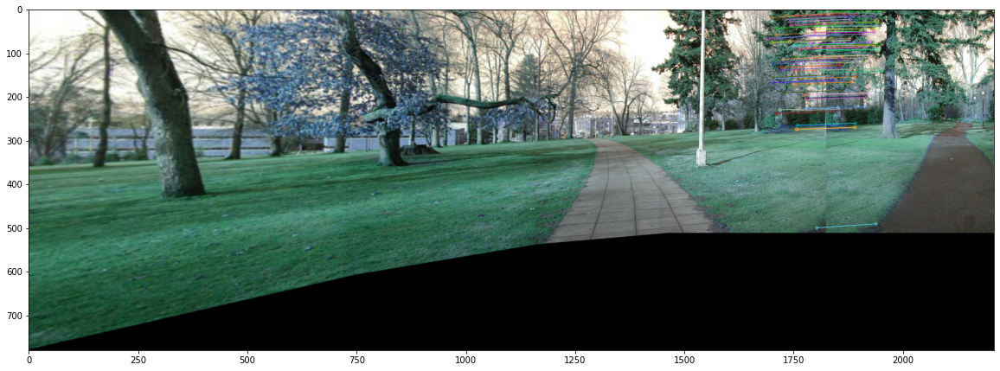

Raw matches (knn): 10029
[[ 8.62470592e-01  1.71464244e-02  2.48187112e+02]
 [-8.98434274e-02  9.76032228e-01  1.69466359e+00]
 [-3.56832988e-04 -2.20695700e-06  1.00000000e+00]]
Stitching picture 6
Using: knn feature matcher
Raw matches (knn): 1576


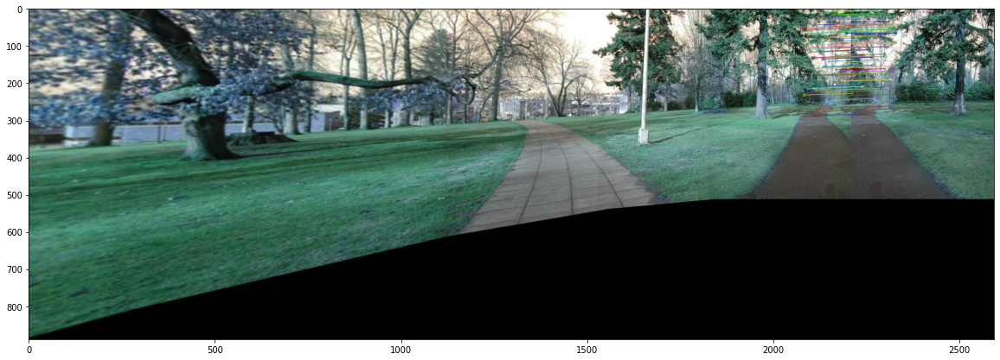

Raw matches (knn): 9669
[[ 8.70597789e-01  1.85926741e-02  2.51420969e+02]
 [-9.07897559e-02  9.78613233e-01  1.68125257e+00]
 [-3.38132015e-04  2.58472144e-06  1.00000000e+00]]
Stitching picture 7
Using: knn feature matcher
Raw matches (knn): 1444


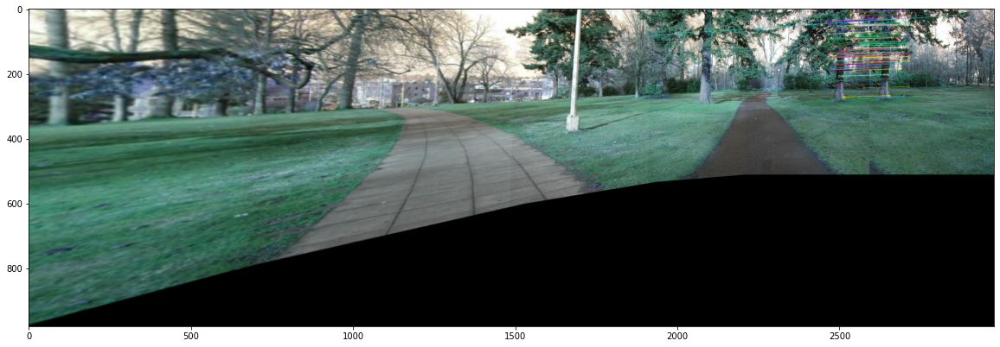

Raw matches (knn): 9020
[[ 8.69382806e-01  1.70323470e-02  2.42321601e+02]
 [-8.84192002e-02  9.76270483e-01  1.76148431e+00]
 [-3.41322972e-04  2.13834828e-07  1.00000000e+00]]
Stitching picture 8
Using: knn feature matcher
Raw matches (knn): 1648


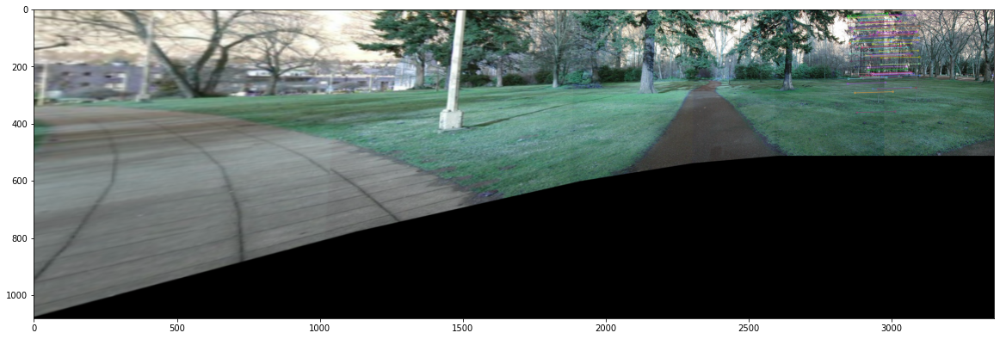

Raw matches (knn): 7975
[[ 8.65266830e-01  1.36847991e-02  2.48083898e+02]
 [-8.93087047e-02  9.75889343e-01  1.95901047e+00]
 [-3.45256065e-04 -2.94220069e-07  1.00000000e+00]]
Stitching picture 9
Using: knn feature matcher
Raw matches (knn): 1607


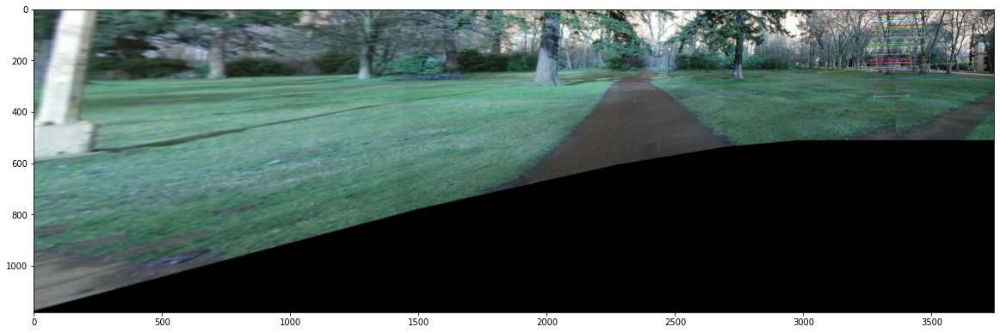

Raw matches (knn): 7339
[[ 8.61547008e-01  1.79907331e-02  2.49395005e+02]
 [-9.26543856e-02  9.77456222e-01  1.51553731e+00]
 [-3.58776038e-04  6.69509944e-07  1.00000000e+00]]
Stitching picture 10
Using: knn feature matcher
Raw matches (knn): 1660


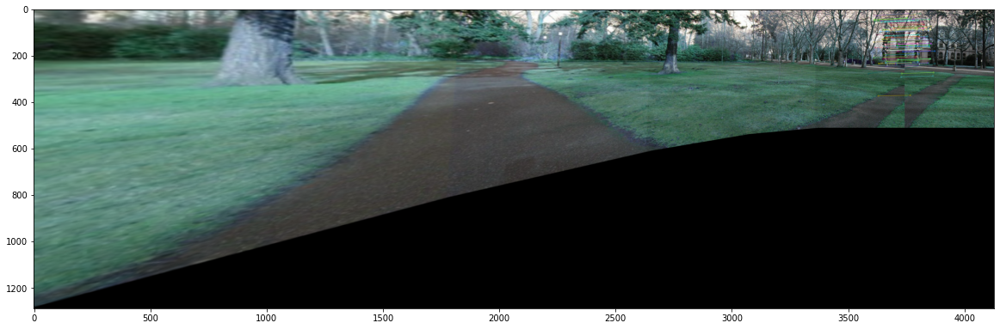

Raw matches (knn): 7011
[[ 8.71159217e-01  1.78102077e-02  2.43888458e+02]
 [-8.72842890e-02  9.78752805e-01  1.80225674e+00]
 [-3.35401490e-04  4.97588777e-06  1.00000000e+00]]
Stitching picture 11
Using: knn feature matcher
Raw matches (knn): 1582


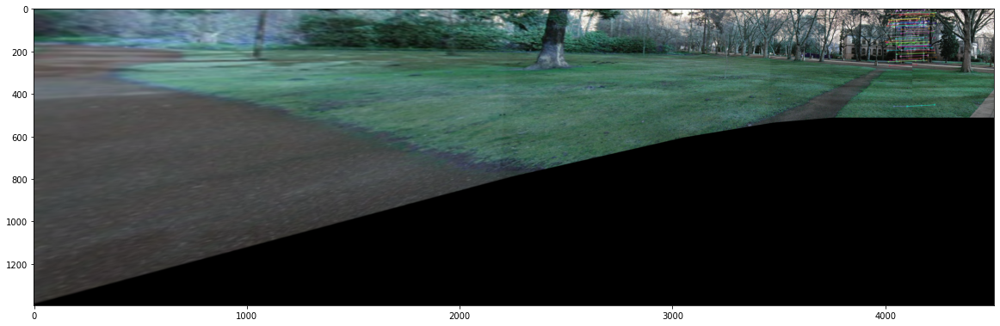

Raw matches (knn): 6842
[[ 8.61197381e-01  1.08380274e-02  2.54699313e+02]
 [-9.25722969e-02  9.79714846e-01  1.38630141e+00]
 [-3.58043386e-04  7.04650973e-06  1.00000000e+00]]
Stitching picture 12
Using: knn feature matcher
Raw matches (knn): 1587


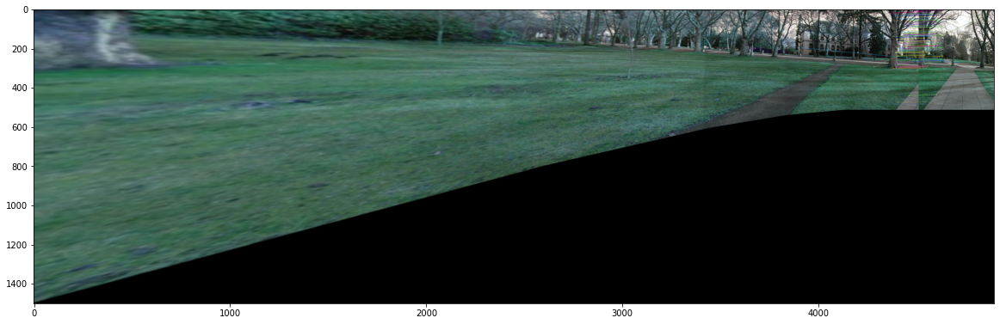

Raw matches (knn): 6597
[[ 8.68893573e-01  1.33681417e-02  2.43565131e+02]
 [-8.80482803e-02  9.74096275e-01  1.81080696e+00]
 [-3.42308806e-04 -8.21741216e-06  1.00000000e+00]]
Stitching picture 13
Using: knn feature matcher
Raw matches (knn): 2174


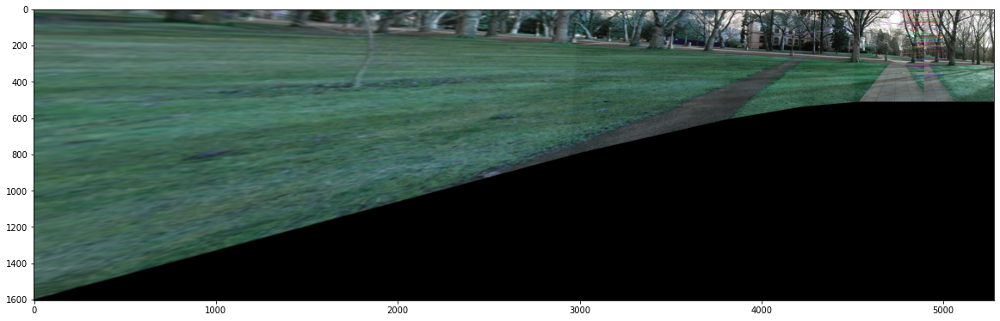

Raw matches (knn): 6536
[[ 8.63395305e-01  8.74122160e-03  2.52510553e+02]
 [-9.20348008e-02  9.75020878e-01  1.86196788e+00]
 [-3.56941758e-04 -5.05000854e-06  1.00000000e+00]]
Stitching picture 14
Using: knn feature matcher
Raw matches (knn): 2118


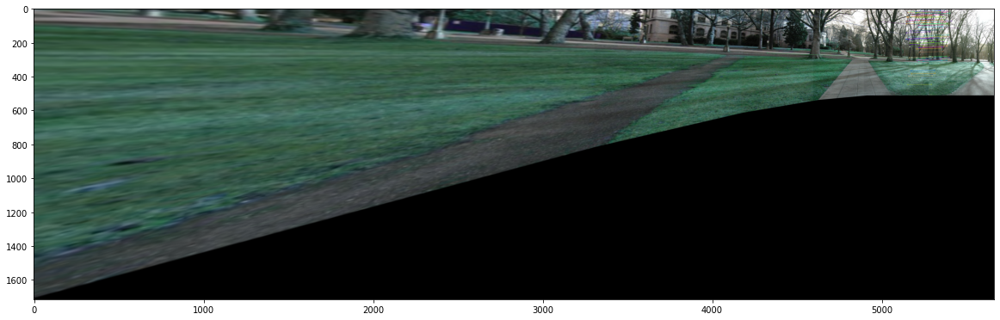

Raw matches (knn): 6304
[[ 8.66810066e-01  1.13289181e-02  2.44225990e+02]
 [-8.83110042e-02  9.77540851e-01  1.71849624e+00]
 [-3.40610769e-04  3.11958982e-06  1.00000000e+00]]
Stitching picture 15
Using: knn feature matcher
Raw matches (knn): 1378


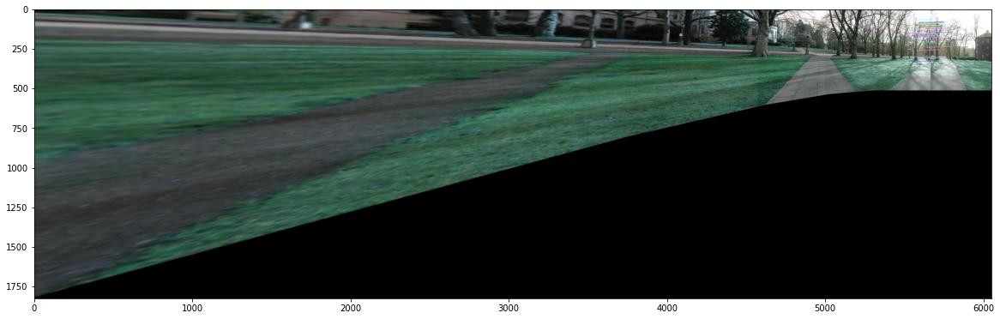

Raw matches (knn): 6688
[[ 8.71306767e-01  4.67899895e-03  2.48041765e+02]
 [-8.46381561e-02  9.77634499e-01  1.38298178e+00]
 [-3.28811760e-04 -8.17307203e-07  1.00000000e+00]]
Stitching picture 16
Using: knn feature matcher
Raw matches (knn): 1103


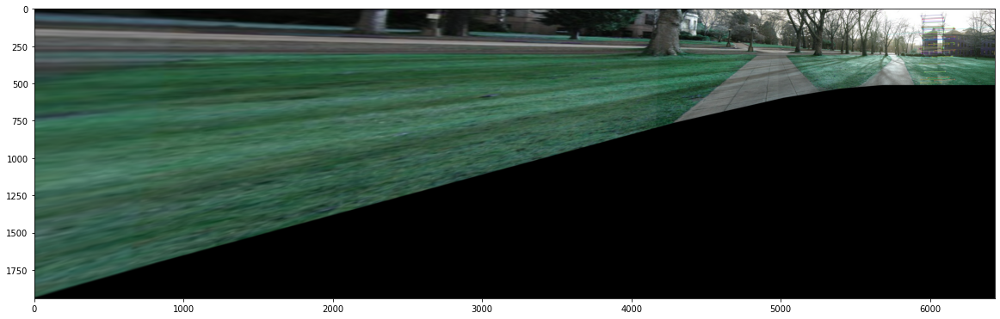

Raw matches (knn): 7545
[[ 8.63552265e-01  7.71079523e-03  2.48597389e+02]
 [-8.98487889e-02  9.76801015e-01  1.78981492e+00]
 [-3.50660166e-04  2.78814236e-06  1.00000000e+00]]


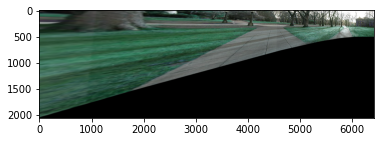

In [177]:
run_main(input_folder_list_txt)

# 分段執行


image folder: /content/drive/MyDrive/other/DataScience/hw3/parrington
img_num = 17
image_left size= (512, 384, 3)
img_right size= (512, 384, 3)


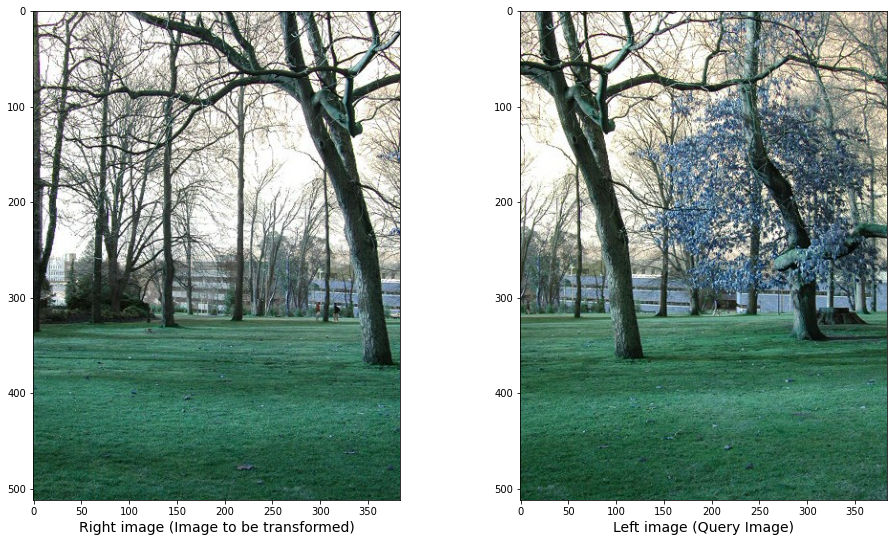

In [167]:
array_of_img = [] # Store all the image data
f = open(input_folder_list_txt, 'r')
dirname = str(f.readline()).strip()
dirname = str(f.readline()).strip() # get folder 2
print("\nimage folder: "+dirname)
read_directory(dirname)

print("img_num = " + str(len(array_of_img)))
#### resize if image is too big
for i in range(0,len(array_of_img)):
    height, width, channels = array_of_img[i].shape
    if height > 800 :
        array_of_img[i] = cv2.resize(array_of_img[i], (int(width/10),int(height/10)), interpolation=cv2.INTER_CUBIC)
#### resize end

# prepare images
img_left = array_of_img[1]
img_right = array_of_img[0]
img_left = cv2.normalize(img_left, None, 0, 255, cv2.NORM_MINMAX).astype('uint8') # make image legal
img_right = cv2.normalize(img_right, None, 0, 255, cv2.NORM_MINMAX).astype('uint8') # make image legal
# flip horizontal
img_left = cv2.flip(img_left, 1)
img_right = cv2.flip(img_right, 1)

# The stitch object to stitch the image
img_left_gray = cv2.cvtColor(img_left, cv2.COLOR_RGB2GRAY)
img_right_gray = cv2.cvtColor(img_right, cv2.COLOR_RGB2GRAY)

# show images
print("image_left size=",img_left.shape)
print("img_right size=",img_right.shape)
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, constrained_layout=False, figsize=(16,9))
ax1.imshow(img_left, cmap="gray")
ax1.set_xlabel("Left image (Query Image)", fontsize=14)
ax2.imshow(img_right, cmap="gray")
ax2.set_xlabel("Right image (Image to be transformed)", fontsize=14)
plt.show()

In [150]:
kpsA, featuresA = detectAndDescribe(img_right_gray, method=feature_extractor) # Transfor
kpsB, featuresB = detectAndDescribe(img_left_gray, method=feature_extractor) # Query

Text(0.5, 0, 'Transfor')

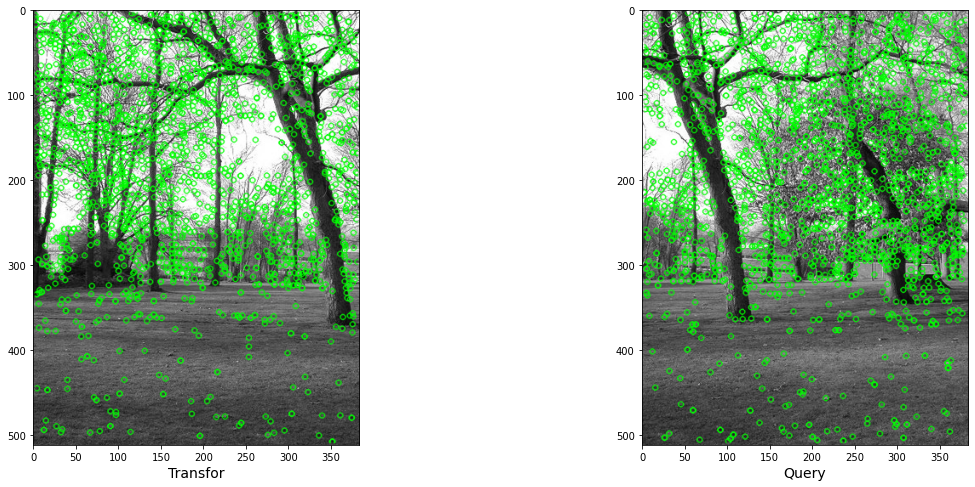

In [170]:
# display the keypoints and features detected on both images
fig, (ax2,ax1) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
ax1.imshow(cv2.flip(cv2.drawKeypoints(img_left_gray,kpsB,None,color=(0,255,0)),1))
ax1.set_xlabel("Query", fontsize=14)
ax2.imshow(cv2.flip(cv2.drawKeypoints(img_right_gray,kpsA,None,color=(0,255,0)),1))
ax2.set_xlabel("Transfor", fontsize=14)

Using: knn feature matcher
Raw matches (knn): 2144


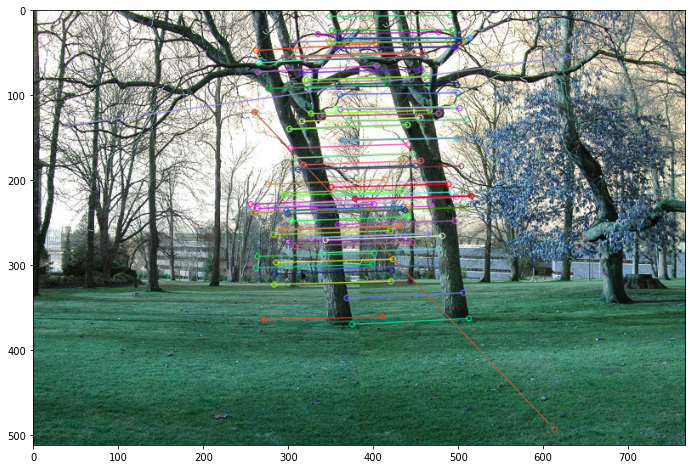

Raw matches (knn): 2089


In [171]:
print("Using: {} feature matcher".format(feature_matching))

fig = plt.figure(figsize=(20,8))

## draw image
if feature_matching == 'bf':
    matches = matchKeyPointsBF(featuresB, featuresA, method=feature_extractor)
    img3 = cv2.drawMatches(img_left,kpsB,img_right,kpsA,matches[:100],
                           None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
elif feature_matching == 'knn':
    matches = matchKeyPointsKNN(featuresB, featuresA, ratio=0.75, method=feature_extractor)
    img3 = cv2.drawMatches(img_left,kpsB,img_right,kpsA,np.random.choice(matches,100),
                           None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS) 
plt.imshow(cv2.flip(img3,1))
plt.show()

## get real matches
if feature_matching == 'bf':
    matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
elif feature_matching == 'knn':
    matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.75, method=feature_extractor)

In [172]:
M = getHomography(kpsA, kpsB, featuresA, featuresB, matches, reprojThresh=4)
if M is None:
    print("Error!")
(matches, H, status) = M
print(H)

[[ 8.69730940e-01  1.33650672e-02  2.44323955e+02]
 [-8.83242363e-02  9.75948223e-01  1.97733391e+00]
 [-3.38913846e-04  6.93709242e-07  1.00000000e+00]]


result size= (1024, 768, 3)


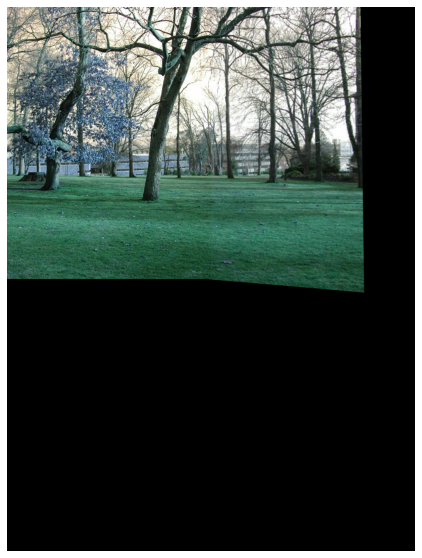

In [173]:
# Apply panorama correction
width = img_right.shape[1] + img_left.shape[1]
height = img_right.shape[0] + img_left.shape[0]

result = cv2.warpPerspective(img_right, H, (width, height))
result[0:img_left.shape[0], 0:img_left.shape[1]] = img_left

print("result size=",result.shape)
plt.figure(figsize=(20,10))
plt.imshow(result)
plt.axis('off')
plt.show()

new size= (538, 673, 3)


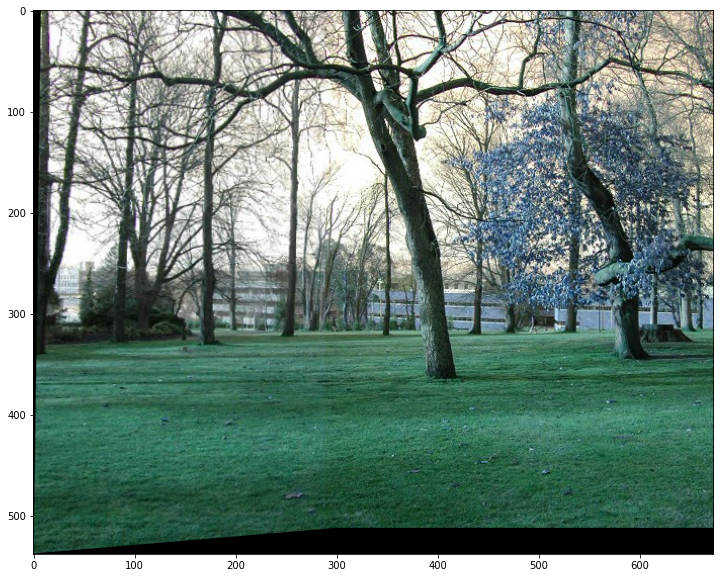

In [174]:
# transform the panorama image to grayscale and threshold it 
gray = cv2.cvtColor(result, cv2.COLOR_BGR2GRAY)
thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)[1]

# Finds contours from the binary image
cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)

# get the maximum contour area
c = max(cnts, key=cv2.contourArea)

# get a bbox from the contour area
(x, y, w, h) = cv2.boundingRect(c)

# crop the image to the bbox coordinates
result = result[y:y + h, x:x + w]
#print("witdh=",w)

# find the min right x and cut the image with it
# min_x2 = 0
# for x2 in range(w-1,0,-1):
#     if sum(result[0][x2]) != 0:
#         min_x2 = x2
#         break
# result = result[0:h, 0:min_x2]

result = cv2.flip(result, 1)
# show the cropped image
print("new size=",result.shape)
plt.figure(figsize=(20,10))
plt.imshow(result)

# 分段執行-2

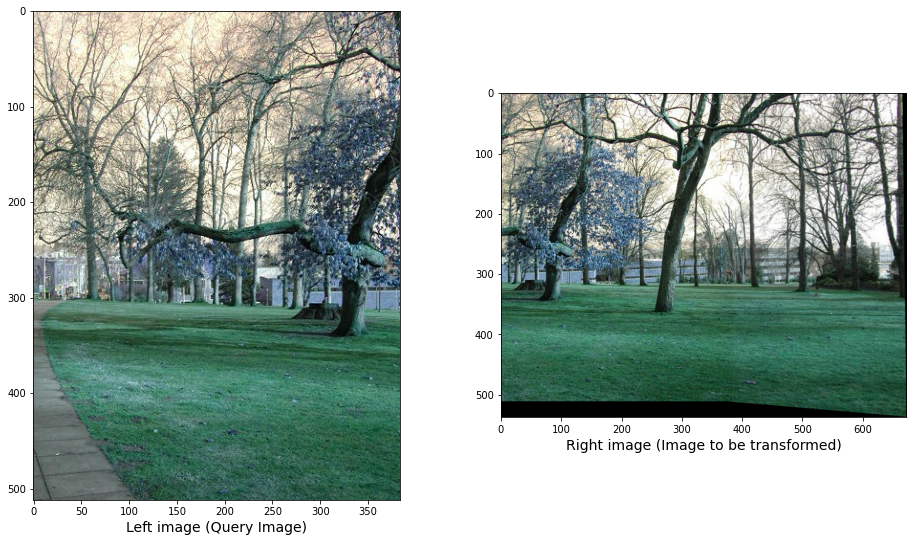

In [138]:
# prepare images
img_left = array_of_img[2]
img_right = result
img_left = cv2.normalize(img_left, None, 0, 255, cv2.NORM_MINMAX).astype('uint8') # make image legal
img_right = cv2.normalize(img_right, None, 0, 255, cv2.NORM_MINMAX).astype('uint8') # make image legal
# flip horizontal
img_left = cv2.flip(img_left, 1)
img_right = cv2.flip(img_right, 1)

# The stitch object to stitch the image
img_left_gray = cv2.cvtColor(img_left, cv2.COLOR_RGB2GRAY)
img_right_gray = cv2.cvtColor(img_right, cv2.COLOR_RGB2GRAY)

# show images
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, constrained_layout=False, figsize=(16,9))
ax1.imshow(img_left, cmap="gray")
ax1.set_xlabel("Left image (Query Image)", fontsize=14)
ax2.imshow(img_right, cmap="gray")
ax2.set_xlabel("Right image (Image to be transformed)", fontsize=14)
plt.show()

In [139]:
kpsA, featuresA = detectAndDescribe(img_right_gray, method=feature_extractor) # Transfor
kpsB, featuresB = detectAndDescribe(img_left_gray, method=feature_extractor) # Query

Text(0.5, 0, 'Transfor')

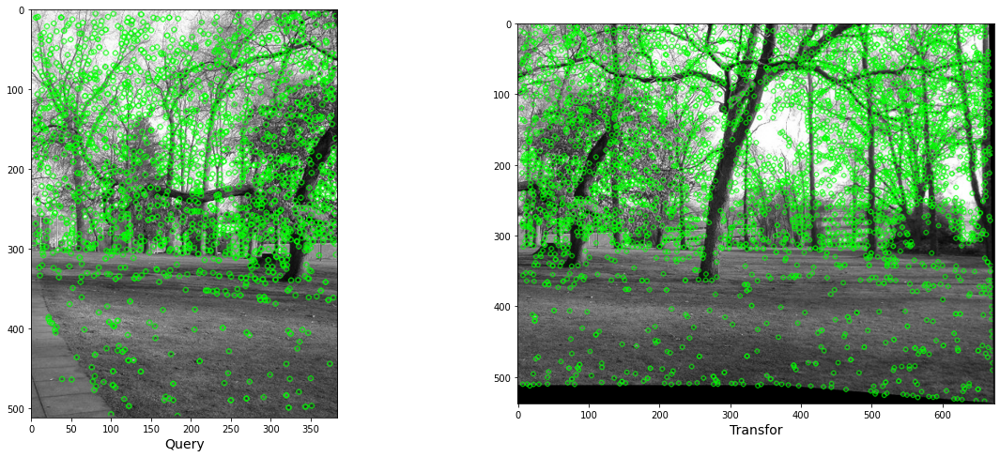

In [140]:
# display the keypoints and features detected on both images
fig, (ax2,ax1) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
ax1.imshow(cv2.drawKeypoints(img_left_gray,kpsB,None,color=(0,255,0)))
ax1.set_xlabel("Query", fontsize=14)
ax2.imshow(cv2.drawKeypoints(img_right_gray,kpsA,None,color=(0,255,0)))
ax2.set_xlabel("Transfor", fontsize=14)

Using: knn feature matcher
Raw matches (knn): 4354


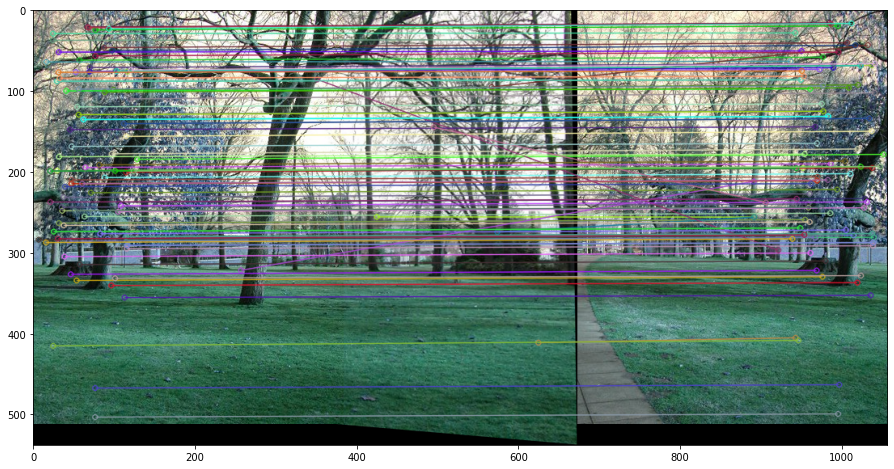

In [141]:
print("Using: {} feature matcher".format(feature_matching))

fig = plt.figure(figsize=(20,8))

## draw image
if feature_matching == 'bf':
    matches = matchKeyPointsBF(featuresB, featuresA, method=feature_extractor)
    img3 = cv2.drawMatches(img_left,kpsB,img_right,kpsA,matches[:100],
                           None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
elif feature_matching == 'knn':
    matches = matchKeyPointsKNN(featuresB, featuresA, ratio=0.75, method=feature_extractor)
    img3 = cv2.drawMatches(img_left,kpsB,img_right,kpsA,np.random.choice(matches,100),
                           None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS) 
plt.imshow(cv2.flip(img3,1))
plt.show()

## get real matches
if feature_matching == 'bf':
    matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
elif feature_matching == 'knn':
    matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.75, method=feature_extractor)

In [142]:
M = getHomography(kpsA, kpsB, featuresA, featuresB, matches, reprojThresh=4)
if M is None:
    print("Error!")
(matches, H, status) = M
print(H)

[[ 8.68656015e-01  1.26569344e-02  2.46962723e+02]
 [-9.00317043e-02  9.77765644e-01  1.73048060e+00]
 [-3.47769012e-04  2.49789175e-06  1.00000000e+00]]


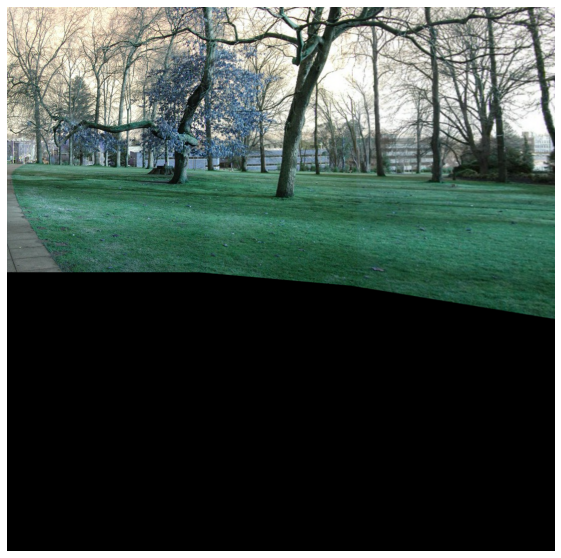

In [143]:
# Apply panorama correction
width = img_right.shape[1] + img_left.shape[1]
height = img_right.shape[0] + img_left.shape[0]

result = cv2.warpPerspective(img_right, H, (width, height))
result[0:img_left.shape[0], 0:img_left.shape[1]] = img_left

plt.figure(figsize=(20,10))
plt.imshow(result)
plt.axis('off')
plt.show()

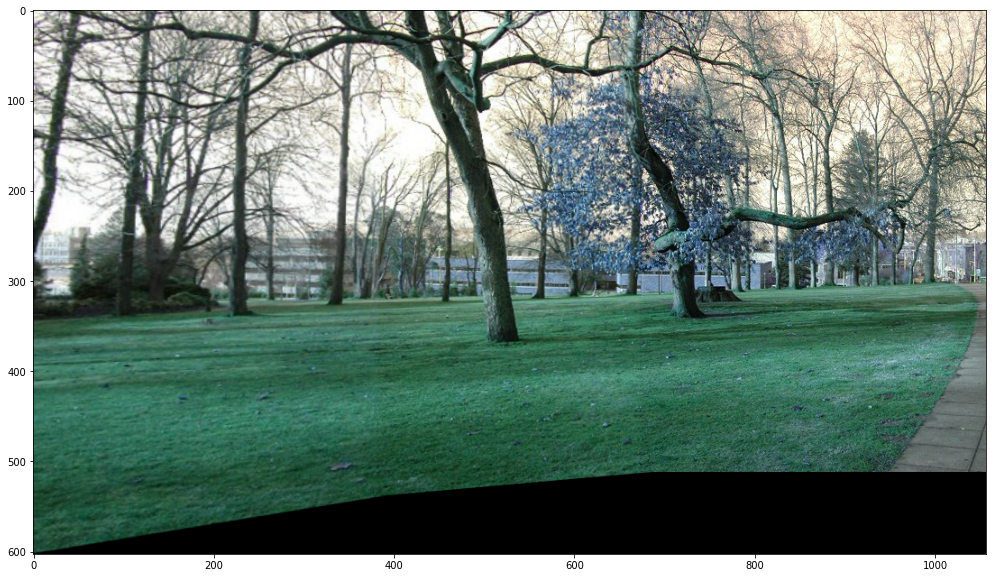

In [145]:
# transform the panorama image to grayscale and threshold it 
gray = cv2.cvtColor(result, cv2.COLOR_BGR2GRAY)
thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)[1]

# Finds contours from the binary image
cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)

# get the maximum contour area
c = max(cnts, key=cv2.contourArea)

# get a bbox from the contour area
(x, y, w, h) = cv2.boundingRect(c)

# crop the image to the bbox coordinates
result = result[y:y + h, x:x + w]

result = cv2.flip(result, 1)
# show the cropped image
plt.figure(figsize=(20,10))
plt.imshow(result)